In [31]:
%matplotlib inline
from matplotlib import style
style.use('fivethirtyeight')
import matplotlib.pyplot as plt

In [32]:
import numpy as np
import pandas as pd
import datetime as dt

# Reflect Tables into SQLAlchemy ORM

In [33]:
# Python SQL toolkit and Object Relational Mapper
import sqlalchemy
from sqlalchemy.ext.automap import automap_base
from sqlalchemy.orm import Session
from sqlalchemy import create_engine, func

In [34]:
# create engine to hawaii.sqlite
engine = create_engine("sqlite:///Resources/hawaii.sqlite")

In [35]:
# reflect an existing database into a new model
Base = automap_base()
# reflect the tables
Base.prepare(engine, reflect=True)


In [36]:
# View all of the classes that automap found
Base.classes.keys()


['measurement', 'station']

In [37]:
# Save references to each table
Measurement = Base.classes.measurement 
Station = Base.classes.station


In [38]:
# Create our session (link) from Python to the DB
session = Session(engine)
for row in session.query(Measurement, Station).all():
    print(row)

(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9B8C8>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9BA48>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9BAC8>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9BB48>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9BBC8>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9BC88>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext.automap.station object at 0x000002DCCCD9BD08>)
(<sqlalchemy.ext.automap.measurement object at 0x000002DCCCD9B788>, <sqlalchemy.ext

# Exploratory Precipitation Analysis

In [39]:
# Find the most recent date in the data set.
session.query(Measurement.date).order_by(Measurement.date.desc()).first().date

'2017-08-23'

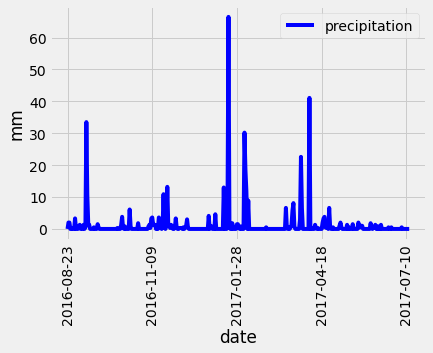

In [40]:
# Design a query to retrieve the last 12 months of precipitation data and plot the results. 
# Starting from the most recent data point in the database. 
# Calculate the date one year from the last date in data set.
results_date=session.query(Measurement.date).order_by(Measurement.date.desc()).first()
str_date=list(np.ravel(results_date))[0]
latest_date=dt.datetime.strptime(str_date,"%Y-%m-%d")
year_back=latest_date-dt.timedelta(days=366)

# Perform a query to retrieve the data and precipitation scores
results=session.query(Measurement.date, Measurement.prcp).order_by(Measurement.date.asc()).\
        filter(Measurement.date>=year_back).\
        group_by(Measurement.date).all()

# Save the query results as a Pandas DataFrame and set the index to the date column
df_results=pd.DataFrame(results,columns=['date', 'prcp'])
df_results=df_results.rename(columns={"prcp":"precipitation"})
df_results.set_index('date', inplace=True)

# Sort the dataframe by date
df_results.sort_values(by=['date'], ascending=True)
df_results=df_results.dropna()
df_results=df_results.reset_index(drop=True)

# Use Pandas Plotting with Matplotlib to plot the data
ax=df_results.plot(color='b',xticks=(0,90,180,270,360),rot=90)
plt.xticks([0,90,180,270,360],['2016-08-23', '2016-11-09', '2017-01-28', '2017-04-18','2017-07-10'])
plt.xlabel("date")
plt.ylabel("mm")
plt.show()



In [41]:
# Use Pandas to calcualte the summary statistics for the precipitation data
df_results.describe()

,precipitation
count,364.000000
mean,1.240385
std,5.200682
min,0.000000
25%,0.000000
50%,0.000000
75%,0.500000
max,66.500000


# Exploratory Station Analysis

In [42]:
# Design a query to calculate the total number stations in the dataset
session.query(Station.id).count()

9

In [43]:
# Design a query to find the most active stations (i.e. what stations have the most rows?)
# List the stations and the counts in descending order.
station_Measurment_join=session.query(Measurement.station,func.count(Measurement.station)).\
                       group_by(Measurement.station).\
                       order_by(func.count(Measurement.station).desc()).all()
station_Measurment_join

[('USC00519281', 2772),
 ('USC00519397', 2724),
 ('USC00513117', 2709),
 ('USC00519523', 2669),
 ('USC00516128', 2612),
 ('USC00514830', 2202),
 ('USC00511918', 1979),
 ('USC00517948', 1372),
 ('USC00518838', 511)]

In [44]:
# Using the most active station id from the previous query, calculate the lowest, highest, and average temperature.
results_temp=session.query(func.min(Measurement.tobs), func.max(Measurement.tobs), func.avg(Measurement.tobs)).\
             filter(Measurement.station==station_Measurment_join[0][0]).all()
results_temp

[(12.2, 29.4, 22.03582251082252)]

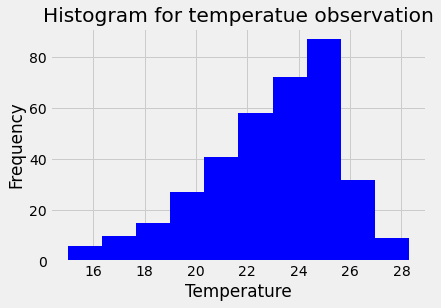

In [45]:
# Using the most active station id
# Query the last 12 months of temperature observation data for this station and plot the results as a histogram
results_date=session.query(Measurement.date).order_by(Measurement.date.desc()).\
             filter(Measurement.station==station_Measurment_join[0][0]).all()
str_date=list(np.ravel(results_date))[0]
latest_date=dt.datetime.strptime(str_date,"%Y-%m-%d")
year_back=latest_date-dt.timedelta(days=366)

results_temp=session.query(Measurement.tobs).\
             filter(Measurement.station==station_Measurment_join[0][0]).\
             filter(Measurement.date>=year_back).all()
df_results=pd.DataFrame(results_temp)

hist = df_results['tobs'].hist(color='b')
hist.set_title("Histogram for temperatue observation")
hist.set_ylabel("Frequency")
hist.set_xlabel("Temperature")
plt.show()


# Close session

In [46]:
# Close Session
session.close()